# Author: Katelyn M Campbell
# Assignment: Capstone Milestone 3- EDA
# Class: DSC-580
# Date: 4/23/2025

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.stats.api as sms
import scipy.stats as stats
import statistics
import numpy as np
from sklearn import linear_model
from sklearn.model_selection import train_test_split
import sklearn
import warnings
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import mean_squared_error, r2_score
import tensorflow as tf
import os
import math
import graphviz
from tensorflow.keras.models import Sequential
from keras.models import Sequential
from keras.layers import Dense
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import Dense
from sklearn.pipeline import Pipeline
from sklearn.tree import plot_tree
from graphviz import Digraph
import matplotlib.image as mpimg
from dash import Dash, dcc, html, Input, Output
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import time
from urllib.request import urlopen
#loads necessary packages

# Help

### Purpose:
To clean and explore data prior to modeling.

### How to Run:
- Run each cell in order (previous generated information may not be captured otherwise).
- Modify the data, graphs, and cleaning techniques as needed.

### What You'll Get:
- Prints and descriptions of the data set.
- Cleaning of missing values, duplicated values, and outliers (options of standard deviations away IQRs away, and log transformation).
- Exploration of any variables that may need their type changed.
- Visualizations, including box plots, histograms, and scatterplots.
- Interactive visualizations, allowing for change of specific country or all data, with box plots, histograms, and line graphs.
- World map interactive visualizations showing individualized and cummulative data.
- Explorations of seasonality and trends.

### Functions Included:
- pd.read_csv()
- pd.merge()
- print ()
- head()
- tail()
- sum()
- isna()
- duplicated()
- dropna()
- drop_duplicates()
- pd.to_datetime()
- mean()
- stdev()
- iqr()
- quantile()
- describe()
- unique()
- pd.DataFrame()
- rolling()
- groupby()
- diff()
- stats.ttest_ind()
- cumsum()
- plot() and relevant graphing functions
- go.Figure() and relevant graphing functions
- px.choropleth() and relevant graphing functions
- boxplot() and relevant graphing functions
- scatter() and relevant graphing functions
- hist() and relevant graphing functions
- to_csv()

Please use the `help(function_name)` in a new cell to learn more about any functions.

Additional note: The interpretations are based on the results last generated by the developer. Any modifications to the data or the process will change the results, and will require new interpretations to be developed.

In [3]:
def log_step(step_name):
 print(f"[{time.strftime('%Y-%m-%d %H:%M:%S')}] {step_name}")
#logs when each step was ran

## Obtaining Data

In [4]:
# option to upload url data
try:
    url = input("Enter the URL to load (.csv or .json): ").strip()
    if url.endswith('.csv'):
        df = pd.read_csv(url)
        print(df)
        print("Remember to update functions to use 'url'")
    elif url.endswith('.json'):
        response = urlopen(url)
        data = json.loads(response.read().decode('utf-8'))
        print(data)
        print("Remember to update models to use 'url'")
    else:
        print("Unsupported file format or no url entered.")
except Exception as e:
    print(f"An error occurred: {e}")
# for reading URL data

Unsupported file format or no url entered.


No URL was entered, so expectations were met.

In [5]:
log_step("Loading Data")
data_vaccine = pd.read_csv("C:/Users/User/Downloads/daily-covid-19-vaccine-doses-administered.csv")
data_deaths = pd.read_csv("C:/Users/User/Downloads/daily-new-confirmed-covid-19-deaths-per-million-people.csv")
data = pd.merge(data_vaccine, data_deaths, on=['Entity', 'Day'], how='inner')
print("Data Loaded")
#loads data and logs time
#can replace path for different data

[2025-04-23 03:25:57] Loading Data
Data Loaded


In [6]:
try:
    data_vaccine2 = pd.read_csv("C:/Users/User/Downloads/daily-covid-19-vaccine-doses-administered.csv")
    data_deaths2 = pd.read_csv("C:/Users/User/Downloads/daily-new-confirmed-covid-19-deaths-per-million-people.csv")
    data2 = pd.merge(data_vaccine2, data_deaths2, on=['Entity', 'Day'], how='inner')
    if 'data' in locals() and data2.equals(data):
        print("Test passed: Merged dataframe matches original.")
    else:
        print("Test passed: Merged dataframe loaded, but does not match the original.")
except Exception as e:
    print(f"Test failed: Error during data loading and merging - {e}")
# tests merging of data

Test passed: Merged dataframe matches original.


The merged data frame is replicated from the original, so test expectations were met.

In [7]:
log_step("Displaying Data")
#prints logged time

[2025-04-23 03:26:04] Displaying Data


In [8]:
print(data)
#prints data

            Entity         Day  COVID-19 doses (daily)  \
0      Afghanistan  2021-05-27                  2859.0   
1      Afghanistan  2021-06-03                  4015.0   
2      Afghanistan  2022-01-27                  6868.0   
3      Afghanistan  2022-04-27                   383.0   
4      Afghanistan  2022-09-12                  9447.0   
...            ...         ...                     ...   
67135     Zimbabwe  2022-09-25                  3446.0   
67136     Zimbabwe  2022-09-26                  2632.0   
67137     Zimbabwe  2022-09-27                 11526.0   
67138     Zimbabwe  2022-10-02                  2276.0   
67139     Zimbabwe  2022-10-03                  1978.0   

       Daily new confirmed deaths due to COVID-19 per million people  
0                                               0.345007              
1                                               0.665371              
2                                               0.098574              
3                  

In [9]:
data.head(10)
#prints first 10 lines of data

,Entity,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people
0,Afghanistan,2021-05-27,2859.0,0.345007
1,Afghanistan,2021-06-03,4015.0,0.665371
2,Afghanistan,2022-01-27,6868.0,0.098574
3,Afghanistan,2022-04-27,383.0,0.000000
4,Afghanistan,2022-09-12,9447.0,0.000000
5,Afghanistan,2022-11-02,36587.0,0.024643
6,Afghanistan,2022-11-16,14800.0,0.024643
7,Afghanistan,2023-04-25,3316.0,0.024643
8,Africa,2020-12-02,0.0,0.212955
9,Africa,2020-12-03,0.0,0.194978


In [10]:
data.tail(10)
#prints last 10 lines of data

,Entity,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people
67130,Zimbabwe,2022-08-20,8840.0,0.186694
67131,Zimbabwe,2022-08-21,2011.0,0.000000
67132,Zimbabwe,2022-08-25,12159.0,0.062231
67133,Zimbabwe,2022-09-23,4405.0,0.062231
67134,Zimbabwe,2022-09-24,7397.0,0.000000
67135,Zimbabwe,2022-09-25,3446.0,0.000000
67136,Zimbabwe,2022-09-26,2632.0,0.000000
67137,Zimbabwe,2022-09-27,11526.0,0.000000
67138,Zimbabwe,2022-10-02,2276.0,0.000000
67139,Zimbabwe,2022-10-03,1978.0,0.062231


In [11]:
log_step("Data Dispayed")
#prints that step was completed

[2025-04-23 03:26:29] Data Dispayed


Data was obtained from Our World in Data, a site that aggregated information
from the World Health Organization (WHO) and a multitude of population details
from various sources (Appel et al., 2025). As WHO is a leader in the research on
the COVID-19 pandemic, this source is appropriate for developing the product.
The data contains 67,140 observations on the entity, day, number of COVID-19
doses administered (daily), and daily new confirmed deaths due to COVID-19.

It was originally hoped that the data set would contain more data. However,
upon inspection of the other data sets available, the larger data sets contained
cumulative data and count data, which would eliminate the possibility of
performing a Poisson regression (Appel et al., 2025). Therefore, the data sets on
the counts of administered vaccines and COVID-19 related deaths were
combined. This was performed using the pd.merge() function, where the entity
and the day were matched within each data set to maintain consistency.
Information on booster doses administered would have caused missing values
within the data, so it was not added.

## Scrubbing Data

In [12]:
log_step("Data Cleaning and Preprocessing")
data['Daily new confirmed deaths due to COVID-19'] = data["Daily new confirmed deaths due to COVID-19 per million people"] *1000000
data.head(10)
#converts data scaling- now data is in approximate count form - necessary for included data set

[2025-04-23 03:26:36] Data Cleaning and Preprocessing


,Entity,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people,Daily new confirmed deaths due to COVID-19
0,Afghanistan,2021-05-27,2859.0,0.345007,345007.360
1,Afghanistan,2021-06-03,4015.0,0.665371,665371.300
2,Afghanistan,2022-01-27,6868.0,0.098574,98573.530
3,Afghanistan,2022-04-27,383.0,0.000000,0.000
4,Afghanistan,2022-09-12,9447.0,0.000000,0.000
5,Afghanistan,2022-11-02,36587.0,0.024643,24643.382
6,Afghanistan,2022-11-16,14800.0,0.024643,24643.382
7,Afghanistan,2023-04-25,3316.0,0.024643,24643.382
8,Africa,2020-12-02,0.0,0.212955,212954.980
9,Africa,2020-12-03,0.0,0.194978,194978.270


In [13]:
print(data.isnull().sum())
#prints a count of how many missing values exist within the data set

Entity                                                           0
Day                                                              0
COVID-19 doses (daily)                                           0
Daily new confirmed deaths due to COVID-19 per million people    0
Daily new confirmed deaths due to COVID-19                       0
dtype: int64


In [14]:
if data.isnull().values.sum() != 0:
    data.isnull().dropna()
    print("N/A values removed from data set.")
else:
    print("No N/A values found in data set.")
# function will remove any NA values found in data set

No N/A values found in data set.


No missing values were found, so no implementation is required.

In [15]:
print(data.duplicated().sum())
#prints a count of how many duplicated lines exist within the data set

0


In [16]:
if data.duplicated().values.sum() != 0:
    data.duplicated().drop_duplicates()
    print("Duplicated values removed from data set.")
else:
    print("No duplicated values found in data set.")
# function will remove any duplicated values found in data set

No duplicated values found in data set.


No duplicated values were found in the data set, so no handling was required.

In [17]:
print(data.dtypes)
#ensures all data has the correct type associated to it - any neccessary implementations will be dependent on each individual data set

Entity                                                            object
Day                                                               object
COVID-19 doses (daily)                                           float64
Daily new confirmed deaths due to COVID-19 per million people    float64
Daily new confirmed deaths due to COVID-19                       float64
dtype: object


In [18]:
data['Day'] = pd.to_datetime(data['Day'])
#converts to date time - valid for original data set used

In [19]:
print(data.dtypes)
#ensures all data has the correct type associated to it

Entity                                                                   object
Day                                                              datetime64[ns]
COVID-19 doses (daily)                                                  float64
Daily new confirmed deaths due to COVID-19 per million people           float64
Daily new confirmed deaths due to COVID-19                              float64
dtype: object


In [20]:
data.describe()
# describes initial data statistics

,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people,Daily new confirmed deaths due to COVID-19
count,67140,6.714000e+04,67140.000000,6.714000e+04
mean,2022-04-18 21:39:23.324396800,7.853590e+05,1.683651,1.683651e+06
min,2020-12-02 00:00:00,0.000000e+00,0.000000,0.000000e+00
25%,2021-07-31 00:00:00,1.754321e+03,0.000000,0.000000e+00
50%,2022-02-08 00:00:00,2.243600e+04,0.176343,1.763430e+05
75%,2022-11-09 00:00:00,2.067128e+05,1.287972,1.287972e+06
max,2024-08-12 00:00:00,4.967320e+07,585.433500,5.854335e+08
std,NaN,3.270447e+06,6.389856,6.389856e+06


In [21]:
mean_vaccine = statistics.mean(data['COVID-19 doses (daily)'])
print("Mean of vaccinations: ", mean_vaccine)
mean_deaths = statistics.mean(data['Daily new confirmed deaths due to COVID-19'])
print("Mean of deaths: ", mean_deaths)
#computes and prints means for both variables

std_dev_vaccine = statistics.stdev(data['COVID-19 doses (daily)'])
print("Standard deviations of vaccinations: ", std_dev_vaccine)
std_dev_deaths = statistics.stdev(data['Daily new confirmed deaths due to COVID-19'])
print("Standard deviation of deaths: ", std_dev_deaths)
#computes and prints standard deviations for both variables

median_vaccine = statistics.median(data['COVID-19 doses (daily)'])
print("Median of vaccinations: ", median_vaccine)
median_deaths = statistics.median(data['Daily new confirmed deaths due to COVID-19'])
print("Median of deaths: ", median_deaths)
#computes medians for both variables

iqr_vaccine = stats.iqr(data['COVID-19 doses (daily)'])
print("IQR of vaccinations: ", iqr_vaccine)
iqr_deaths = stats.iqr(data['Daily new confirmed deaths due to COVID-19'])
print("IQR of deaths: ", iqr_deaths)
#computes and prints iqr for both variables

q1_vaccine = np.quantile(data['COVID-19 doses (daily)'], 0.25)
q3_vaccine = np.quantile(data['COVID-19 doses (daily)'], 0.75)
q1_deaths = np.quantile(data['Daily new confirmed deaths due to COVID-19'], 0.25)
q3_deaths = np.quantile(data['Daily new confirmed deaths due to COVID-19'], 0.75)
#computes quartiles for both variables

Mean of vaccinations:  785359.0171810848
Mean of deaths:  1683651.4681094966
Standard deviations of vaccinations:  3270446.8619633247
Standard deviation of deaths:  6389855.839281419
Median of vaccinations:  22436.0
Median of deaths:  176343.04
IQR of vaccinations:  204958.42855
IQR of deaths:  1287971.8


In [22]:
vaccine_mean_outlier_high = mean_vaccine + (std_dev_vaccine * 3)
vaccine_mean_outlier_low = mean_vaccine - (std_dev_vaccine * 3)
print('Potential outliers for vaccines based on mean: ', 'high: ', vaccine_mean_outlier_high,\
      'low: ', vaccine_mean_outlier_low)

death_mean_outlier_high = mean_deaths + (std_dev_deaths * 3)
death_mean_outlier_low = mean_deaths - (std_dev_deaths * 3)
print('Potential outliers for deaths based on mean: ', 'high: ', death_mean_outlier_high,\
      'low: ', death_mean_outlier_low)

vaccine_median_outlier_high = q3_vaccine + (iqr_vaccine * 1.5)
vaccine_median_outlier_low = q1_vaccine - (iqr_vaccine * 1.5)
print('Potential outliers for vaccines based on median: ', 'high: ', vaccine_median_outlier_high,\
      'high: ', vaccine_median_outlier_high)

death_median_outlier_high = q3_deaths + (iqr_deaths * 1.5)
death_median_outlier_low = q1_deaths - (iqr_deaths * 1.5)
print('Potential outliers for deaths based on median: ', 'high: ', death_median_outlier_high,\
      'low: ', death_median_outlier_low)
#calculates and prints the cut offs for outliers

Potential outliers for vaccines based on mean:  high:  10596699.60307106 low:  -9025981.56870889
Potential outliers for deaths based on mean:  high:  20853218.985953756 low:  -17485916.049734764
Potential outliers for vaccines based on median:  high:  514150.392825 high:  514150.392825
Potential outliers for deaths based on median:  high:  3219929.5 low:  -1931957.7000000002


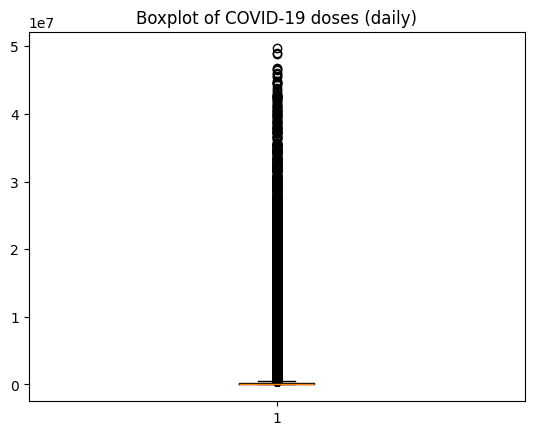

<Figure size 640x480 with 0 Axes>

In [23]:
plt.boxplot(data['COVID-19 doses (daily)'])
plt.title("Boxplot of COVID-19 doses (daily)")
plt.show()
plt.savefig("boxplot_COVID-19_vaccine.png")
#creates and saves boxplot to visualize outliers of vaccines

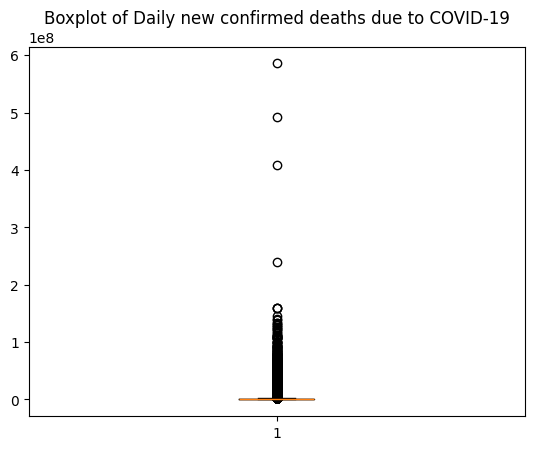

<Figure size 640x480 with 0 Axes>

In [24]:
plt.boxplot(data['Daily new confirmed deaths due to COVID-19'])
plt.title("Boxplot of Daily new confirmed deaths due to COVID-19")
plt.show()
plt.savefig("boxplot_COVID-19_deaths.png")
#creates and saves boxplot to visualize outliers of deaths

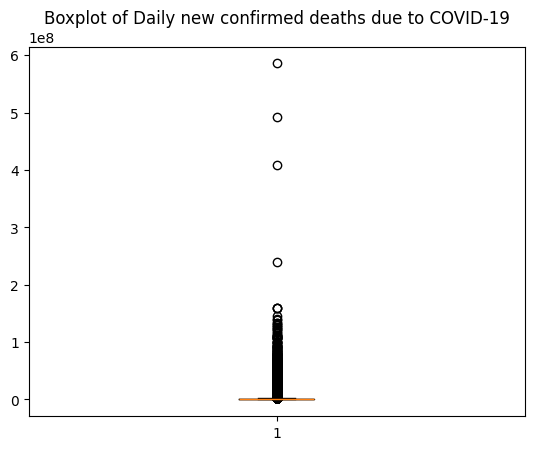

<Figure size 640x480 with 0 Axes>

In [25]:
try:
    plt.boxplot(data['Daily new confirmed deaths due to COVID-19'])
    plt.title("Boxplot of Daily new confirmed deaths due to COVID-19")
    plt.show()
    plt.savefig("boxplot_COVID-19_deaths.png")
except Exception as e:
    print(f"Box plot failed: {e}")
# tests box plot

A boxplot was generated, meeting test expectations.

In [26]:
vaccine_hmean_outlier_count = np.sum(data['COVID-19 doses (daily)'] > vaccine_mean_outlier_high)
vaccine_lmean_outlier_count = np.sum(data['COVID-19 doses (daily)'] < vaccine_mean_outlier_low)
vaccine_mean_outlier_count = vaccine_hmean_outlier_count + vaccine_lmean_outlier_count
print("Vaccine number of outliers based on mean: ", vaccine_mean_outlier_count)

vaccine_hmedian_outlier_count = np.sum(data['COVID-19 doses (daily)'] > vaccine_median_outlier_high)
vaccine_lmedian_outlier_count = np.sum(data['COVID-19 doses (daily)'] < vaccine_median_outlier_low)
vaccine_median_outlier_count = vaccine_hmedian_outlier_count + vaccine_lmedian_outlier_count
print("Vaccine number of outliers based on median: ", vaccine_median_outlier_count)

death_hmean_outlier_count = np.sum(data['Daily new confirmed deaths due to COVID-19']> death_mean_outlier_high)
death_lmean_outlier_count = np.sum(data['Daily new confirmed deaths due to COVID-19']< death_mean_outlier_low)
death_mean_outlier_count = death_hmean_outlier_count + death_lmean_outlier_count
print("Death number of outliers based on mean: ", death_mean_outlier_count)

death_hmedian_outlier_count = np.sum(data['Daily new confirmed deaths due to COVID-19']> death_median_outlier_high)
death_lmedian_outlier_count = np.sum(data['Daily new confirmed deaths due to COVID-19']< death_median_outlier_low)
death_median_outlier_count = death_hmedian_outlier_count + death_lmedian_outlier_count
print("Death number of outliers based on median: ", death_median_outlier_count)
#counts how many total outliers exist within the data set

Vaccine number of outliers based on mean:  1247
Vaccine number of outliers based on median:  10842
Death number of outliers based on mean:  629
Death number of outliers based on median:  8404


In [27]:
if vaccine_mean_outlier_count + death_mean_outlier_count != 0:
    print("Outlier detected over 3 standard deviations away. Outlier handling is necessary")
else:
    print("No outliers found in data set through standard deviations.")

if vaccine_median_outlier_count + death_median_outlier_count != 0:
    print("Outlier detected over 1.5 IQRs away. Outlier handling is necessary")
else:
    print("No outliers found in data set through IQRs away.")

# function will identify if any outliers are present through standard deviations or IQRs away

Outlier detected over 3 standard deviations away. Outlier handling is necessary
Outlier detected over 1.5 IQRs away. Outlier handling is necessary


Outliers were found, so outlier handling is required.

In [28]:
data_nomean_out = {}
data_nomean_out = pd.DataFrame(data_nomean_out)
data_nomean_out['COVID-19 doses (daily, no outliers)'] = data['COVID-19 doses (daily)'].clip(lower=vaccine_mean_outlier_low, upper=vaccine_mean_outlier_high)
data_nomean_out['Daily new confirmed deaths due to COVID-19 (no outliers)'] = data['Daily new confirmed deaths due to COVID-19'].clip(lower=death_mean_outlier_low, upper=death_mean_outlier_high)
#creates new data set where outliers have been removed through standard deviations

data_nomedian_out = {}
data_nomedian_out = pd.DataFrame(data_nomedian_out) 
data_nomedian_out['COVID-19 doses (daily, no outliers)'] = data['COVID-19 doses (daily)'].clip(lower=vaccine_median_outlier_low, upper=vaccine_median_outlier_high)
data_nomedian_out['Daily new confirmed deaths due to COVID-19 (no outliers)'] = data['Daily new confirmed deaths due to COVID-19'].clip(lower=death_median_outlier_low, upper=death_median_outlier_high)
#creates new data set where outliers have been removed through IQR

In [29]:
print(data_nomean_out.isnull().sum())
print(data_nomedian_out.isnull().sum())
#prints a count of how many missing values exist within the data set

COVID-19 doses (daily, no outliers)                         0
Daily new confirmed deaths due to COVID-19 (no outliers)    0
dtype: int64
COVID-19 doses (daily, no outliers)                         0
Daily new confirmed deaths due to COVID-19 (no outliers)    0
dtype: int64


In [30]:
if data_nomean_out.isnull().values.sum() != 0:
    data_nomean_out.isnull().dropna()
    print("N/A values removed from data set where outliers over 3 standard deviations away were removed.")
else:
    print("No N/A values found in data set where outliers over 3 standard deviations away were removed.")

if data_nomedian_out.isnull().values.sum() != 0:
    data_nomedian_out.isnull().dropna()
    print("N/A values removed from data set where outliers over 1.5 IQRs away were removed.")
else:
    print("No N/A values found in data set where outliers over 1.5 IQRs away were removed.")   
# function will remove any NA values found in data set

No N/A values found in data set where outliers over 3 standard deviations away were removed.
No N/A values found in data set where outliers over 1.5 IQRs away were removed.


No missing values were found after outlier removal, meeting test expectations.

In [31]:
data_nomean_out.describe()
#gets new summary statistics after outliers removed

,"COVID-19 doses (daily, no outliers)",Daily new confirmed deaths due to COVID-19 (no outliers)
count,6.714000e+04,6.714000e+04
mean,5.873528e+05,1.461546e+06
std,1.808541e+06,3.278568e+06
min,0.000000e+00,0.000000e+00
25%,1.754321e+03,0.000000e+00
50%,2.243600e+04,1.763430e+05
75%,2.067128e+05,1.287972e+06
max,1.059670e+07,2.085322e+07


In [32]:
data_nomedian_out.describe()
#gets new summary statistics after outliers removed

,"COVID-19 doses (daily, no outliers)",Daily new confirmed deaths due to COVID-19 (no outliers)
count,67140.000000,6.714000e+04
mean,135163.677435,8.187146e+05
std,192444.238032,1.146300e+06
min,0.000000,0.000000e+00
25%,1754.321450,0.000000e+00
50%,22436.000000,1.763430e+05
75%,206712.750000,1.287972e+06
max,514150.392825,3.219930e+06


In [33]:
data_log ={}
data_log = pd.DataFrame(data_log)
data_log['COVID-19 doses (daily)'] = np.log1p(data['COVID-19 doses (daily)'])
data_log['Daily new confirmed deaths due to COVID-19'] =np.log1p(data['Daily new confirmed deaths due to COVID-19'])
# applies log transformation on data

In [34]:
print(data_log.isnull().sum())
print("Min vaccine doses:", data['COVID-19 doses (daily)'].min())
print("Min deaths:", data['Daily new confirmed deaths due to COVID-19'].min())
#prints a count of how many missing or negative values exist within the data

COVID-19 doses (daily)                        0
Daily new confirmed deaths due to COVID-19    0
dtype: int64
Min vaccine doses: 0.0
Min deaths: 0.0


In [35]:
if (data_log < 0).any().any():
    print("Log transformation not valid. Negative values exist.")
else:
    print("Log transformation successful. No negative values present.")
# function will print validity of transformation

if data_log.isnull().values.sum() != 0:
    data_log.isnull().dropna()
    print("N/A values removed from data set with log transformation.")
else:
    print("No N/A values found in data set with log transformation.")   
# function will remove any NA values found in data set

Log transformation successful. No negative values present.
No N/A values found in data set with log transformation.


Log transformation occurred, with no negative values or missing values. Test expectations were met.

In [36]:
data_log.describe()
#prints summary of data after log transformation

,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19
count,67140.000000,67140.000000
mean,9.658036,8.522092
std,3.609422,6.585103
min,0.000000,0.000000
25%,7.470407,0.000000
50%,10.018467,12.080192
75%,12.239090,14.068580
max,17.720976,20.187863


In [37]:
log_step("Data Cleaned and Preprocessed")
#prints that step was completed

[2025-04-23 03:28:29] Data Cleaned and Preprocessed


Data scrubbing and cleaning involved a conversion, checking for missing values,
duplicated observations, appropriate data types assigned, and outlier
examination (National Cancer Institute, 2023). When the data set was uploaded
and printed, the number of deaths was in per million. This value was converted
into the original count by multiplying a million and made as a new column in the
data frame. Using the isnull() with the sum() function, it was shown that there
were no missing values. The duplicated() and sum() functions were also
performed to search for duplicated observations, which none were found. As for
the data type, applying dtypes to the data resulted in entity as an object, day as
an object, COVID-19 doses (daily) as a float, daily new confirmed deaths due to
COVID-19 per million people as a float, and daily new confirmed deaths due to
COVID-19 as a float. All of these are appropriate, with the exception of the day.
This was converted into date time format using pd.to_datetime().

With the outliers, four techniques were utilized to compare against. There were
many found, as 1,247 were found using three standard deviations away from the
mean and 10,842 were found using one and a half interquartile ranges away
from the median for the vaccination doses administered. With the number of
deaths, this was 629 data points outside of three standard deviations away and
8,404 one and a half interquartile ranges away from the median. Due to the
large amount of outliers, the first method chosen was to keep them and examine
the impact they had on the data set. The next two used were to remove outliers
far away from the mean and median. The final method attempted, which had the
strongest influence on the data structure, was a log transformation. These methods were all included as differing models may have a higher performance
with differing outlier handling methods. Literature reviews show that there is not a standard method in outlier handling, therefore, multiple were used to identify which is most appropriate for the current data (Aguinis et al., 2013). All will be compared against one another
to find the best, given the data set at hand.

## Exploring Data (EDA)

In [38]:
log_step("Exploring Data")
data.head(10)
#logs when step was ran and prints first 10 lines of data

[2025-04-23 03:28:29] Exploring Data


,Entity,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people,Daily new confirmed deaths due to COVID-19
0,Afghanistan,2021-05-27,2859.0,0.345007,345007.360
1,Afghanistan,2021-06-03,4015.0,0.665371,665371.300
2,Afghanistan,2022-01-27,6868.0,0.098574,98573.530
3,Afghanistan,2022-04-27,383.0,0.000000,0.000
4,Afghanistan,2022-09-12,9447.0,0.000000,0.000
5,Afghanistan,2022-11-02,36587.0,0.024643,24643.382
6,Afghanistan,2022-11-16,14800.0,0.024643,24643.382
7,Afghanistan,2023-04-25,3316.0,0.024643,24643.382
8,Africa,2020-12-02,0.0,0.212955,212954.980
9,Africa,2020-12-03,0.0,0.194978,194978.270


In [39]:
data.describe()
#reports summary statistics on data

,Day,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19 per million people,Daily new confirmed deaths due to COVID-19
count,67140,6.714000e+04,67140.000000,6.714000e+04
mean,2022-04-18 21:39:23.324396800,7.853590e+05,1.683651,1.683651e+06
min,2020-12-02 00:00:00,0.000000e+00,0.000000,0.000000e+00
25%,2021-07-31 00:00:00,1.754321e+03,0.000000,0.000000e+00
50%,2022-02-08 00:00:00,2.243600e+04,0.176343,1.763430e+05
75%,2022-11-09 00:00:00,2.067128e+05,1.287972,1.287972e+06
max,2024-08-12 00:00:00,4.967320e+07,585.433500,5.854335e+08
std,NaN,3.270447e+06,6.389856,6.389856e+06


In [40]:
unique_countries = data["Entity"].unique()
# obtains each different country name

In [41]:
fig_box1 = go.Figure()
# Add traces for each country
for country in unique_countries:
 country_data = data[data["Entity"] == country]
 fig_box1.add_trace(
 go.Box(
 y=country_data["COVID-19 doses (daily)"],
 name=country,
 visible=False # Initially hide all countries
 )
 )
dropdown_buttons = [
 {
 "label": country,
 "method": "update",
 "args": [{"visible": [country == c for c in unique_countries]}]
 }
 for country in unique_countries
]
# Add a "Show All" option
dropdown_buttons.insert(0, {
 "label": "Show All",
 "method": "update",
 "args": [{"visible": [True] * len(unique_countries)}]
})
# Update layout to include dropdown
fig_box1.update_layout(
 updatemenus=[{
 "buttons": dropdown_buttons,
 "direction": "down",
 "showactive": True,
 }],
 title="COVID-19 Vaccinations Box Plot",
 yaxis_title="COVID-19 Vaccinations",
)
fig_box1.show()
# creates interactive box plot of COVID-19 vaccinations administered

In [42]:
fig_box2 = go.Figure()
# Add traces for each country
for country in unique_countries:
 country_data = data[data["Entity"] == country]
 fig_box2.add_trace(
 go.Box(
 y=country_data["Daily new confirmed deaths due to COVID-19"],
 name=country,
 visible=False # Initially hide all countries 
 )
 )
dropdown_buttons = [
 {
 "label": country,
 "method": "update",
 "args": [{"visible": [country == c for c in unique_countries]}]
 }
 for country in unique_countries
]
# Add a "Show All" option
dropdown_buttons.insert(0, {
 "label": "Show All",
 "method": "update",
 "args": [{"visible": [True] * len(unique_countries)}]
})
# Update layout to include dropdown
fig_box2.update_layout(
 updatemenus=[{
 "buttons": dropdown_buttons,
 "direction": "down",
 "showactive": True,
 }],
 title="COVID-19 Related Deaths Box Plot",
 yaxis_title="COVID-19 Related Deaths",
)
fig_box2.show()
# creates interactive box plot of COVID-19 related deaths

In [43]:
fig_hist1 = go.Figure()
# Add traces for each country
for country in unique_countries:
        country_data = data[data["Entity"] == country]
        fig_hist1.add_trace(
                go.Histogram(
                        x=country_data["COVID-19 doses (daily)"],
                        name=country,
                        visible=False # Initially hide all countries
                        )
                        )
dropdown_buttons = [
        {
                "label": country,
                "method": "update",
                "args": [{"visible": [country == c for c in unique_countries]}]
                }
                for country in unique_countries
                ]
# Add a "Show All" option
dropdown_buttons.insert(0, {
        "label": "Show All",
        "method": "update",
        "args": [{"visible": [True] * len(unique_countries)}]
        })
# Update layout to include dropdown
fig_hist1.update_layout(
        updatemenus=[{
                "buttons": dropdown_buttons,
                "direction": "down",
                "showactive": True,
                }],
                title="Histogram of COVID-19 Doses Daily",
                xaxis_title="Day",
                yaxis_title="COVID-19 Daily Vaccinations"
                )
fig_hist1.show()
# creates interactive histogram of COVID-19 vaccinations administered

In [44]:
fig_hist2 = go.Figure()
# Add traces for each country
for country in unique_countries:
 country_data = data[data["Entity"] == country]
 fig_hist2.add_trace(
 go.Histogram(
 x=country_data["Daily new confirmed deaths due to COVID-19"],
 name=country,
 visible=False # Initially hide all countries
 )
 )
dropdown_buttons = [
 {
 "label": country,
 "method": "update",
 "args": [{"visible": [country == c for c in unique_countries]}]
 }
 for country in unique_countries
]
# Add a "Show All" option
dropdown_buttons.insert(0, {
 "label": "Show All",
 "method": "update",
 "args": [{"visible": [True] * len(unique_countries)}]
})
# Update layout to include dropdown
fig_hist2.update_layout(
 updatemenus=[{
  "buttons": dropdown_buttons,
 "direction": "down",
 "showactive": True,

}],
 title="Histogram of COVID-19 Related Deaths Over Time",
 xaxis_title="Day",
 yaxis_title="COVID-19 Related Deaths",
)
fig_hist2.show()
# creates interactive histogram of COVID-19 related deaths

In [45]:
fig_line1 = go.Figure()
# Add traces for each country
for country in unique_countries:
 country_data = data[data["Entity"] == country]
 fig_line1.add_trace(
 go.Scatter(
 x=country_data["Day"],
 y=country_data["COVID-19 doses (daily)"],
 mode="lines",
 name=country,
 visible=False
 )
 )
dropdown_buttons = [
 {
 "label": country,
 "method": "update",
 "args": [{"visible": [country == c for c in unique_countries]}]
 }
 for country in unique_countries
]
# Add a "Show All" option
dropdown_buttons.insert(0, {
 "label": "Show All",
 "method": "update",
 "args": [{"visible": [True] * len(unique_countries)}]
})
# Update layout to include dropdown
fig_line1.update_layout(
 updatemenus=[{
 "buttons": dropdown_buttons,
 "direction": "down",
 "showactive": True,
 }],
 title="COVID-19 Doses Over Time",
 xaxis_title="Day",
 yaxis_title="COVID-19 doses (daily)",
)
fig_line1.show()
# creates interactive line graph of COVID-19 vaccinations administered over time

In [46]:
fig_line2 = go.Figure()
# Add traces for each country
for country in unique_countries:
 country_data = data[data["Entity"] == country]
 fig_line2.add_trace(
 go.Scatter(
 x=country_data["Day"],
 y=country_data["Daily new confirmed deaths due to COVID-19"],
 mode="lines",
 name=country,
 visible=False
 )
 )
dropdown_buttons = [
 {
 "label": country,
 "method": "update",
 "args": [{"visible": [country == c for c in unique_countries]}]
 }
 for country in unique_countries
]
# Add a "Show All" option
dropdown_buttons.insert(0, {
 "label": "Show All",
 "method": "update",
 "args": [{"visible": [True] * len(unique_countries)}]
})
# Update layout to include dropdown
fig_line2.update_layout(
 updatemenus=[{
 "buttons": dropdown_buttons,
 "direction": "down",
 "showactive": True,
 }],
 title="COVID-19 Related Deaths Over Time",
 xaxis_title="Day",
 yaxis_title="COVID-19 Related Deaths",
)
fig_line2.show()
# creates interactive line graph of COVID-19 related deaths over time

In [47]:
try:
    for country in unique_countries:
        country_data = data[data["Entity"] == country]
        fig_line2.add_trace(
        go.Scatter(
        x=country_data["Day"],
        y=country_data["Daily new confirmed deaths due to COVID-19"],
        mode="lines",
        name=country,
        visible=False
        )
        )
    dropdown_buttons = [
        {
        "label": country,
        "method": "update",
        "args": [{"visible": [country == c for c in unique_countries]}]
        }
    for country in unique_countries
    ]
   
    dropdown_buttons.insert(0, {
        "label": "Show All",
        "method": "update",
        "args": [{"visible": [True] * len(unique_countries)}]
        })
    
    fig_line2.update_layout(
        updatemenus=[{
        "buttons": dropdown_buttons,
        "direction": "down",
        "showactive": True,
        }],
        title="COVID-19 Related Deaths Over Time",
        xaxis_title="Day",
        yaxis_title="COVID-19 Related Deaths",
    )
    fig_line2.show()
except Exception as e:
    print(f"go.Figure graph failed: {e}")
# tests go.Figure graphs

An interactive graph was generated, meeting test expecations.

In [48]:
data_grouped = data.groupby('Day')[['COVID-19 doses (daily)', 'Daily new confirmed deaths due to COVID-19']].sum()
#groups data by day for trend and seasonality analysis

In [49]:
try: 
    data_grouped2 = data.groupby('Day')[['COVID-19 doses (daily)', 'Daily new confirmed deaths due to COVID-19']].sum()
    if 'data_grouped' in locals() and data_grouped2.equals(data_grouped):
        print("Dataframes are identical.")
    else:
        print("Grouped data created.")
except Exception as e:
    print(f"Grouped data failed: {e}")
# tests grouped data

Dataframes are identical.


The data frames grouped the same and are identical, meeting test expectations.

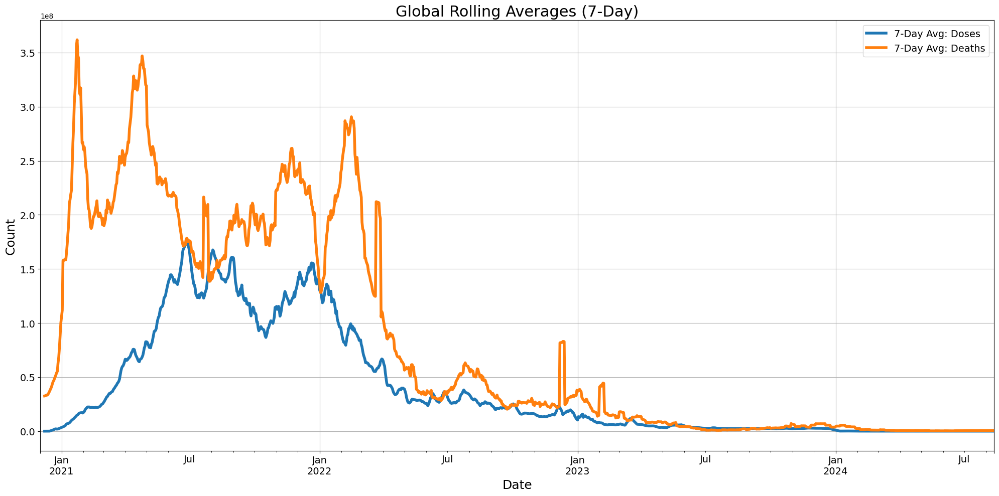

In [50]:
data_rolling7 = data_grouped.rolling(7).mean()
data_rolling7.plot(figsize=(20, 10), linewidth=4, fontsize=14)
plt.title('Global Rolling Averages (7-Day)', fontsize=22)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.grid(True)
plt.legend(['7-Day Avg: Doses', '7-Day Avg: Deaths'], fontsize=14)
plt.tight_layout()
plt.savefig("line_COVID-19_7mavg.png")
#graphs and saves with weekly rolling averages

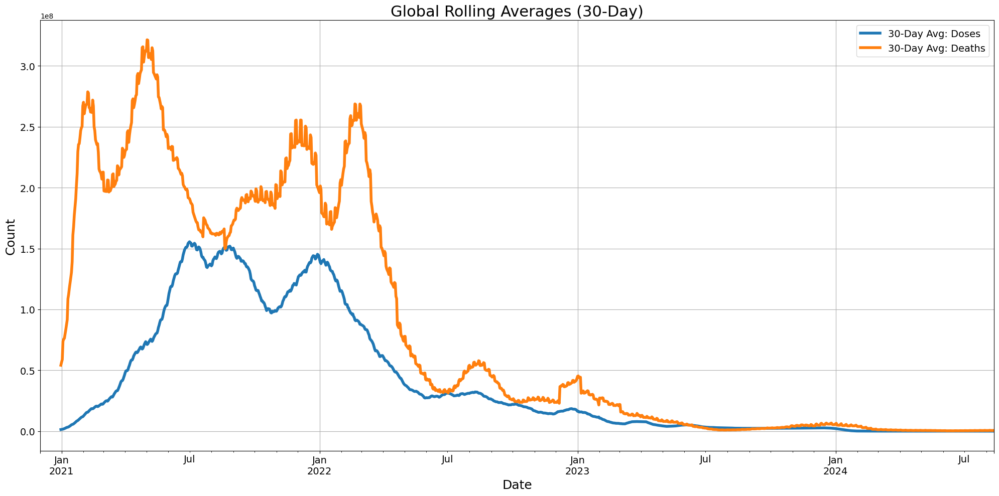

In [51]:
data_rolling30 = data_grouped.rolling(30).mean()
data_rolling30.plot(figsize=(20, 10), linewidth=4, fontsize=14)
plt.title('Global Rolling Averages (30-Day)', fontsize=22)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.grid(True)
plt.legend(['30-Day Avg: Doses', '30-Day Avg: Deaths'], fontsize=14)
plt.tight_layout()
plt.savefig("line_COVID-19_30mavg.png")
#graphs and saves with monthly rolling averages

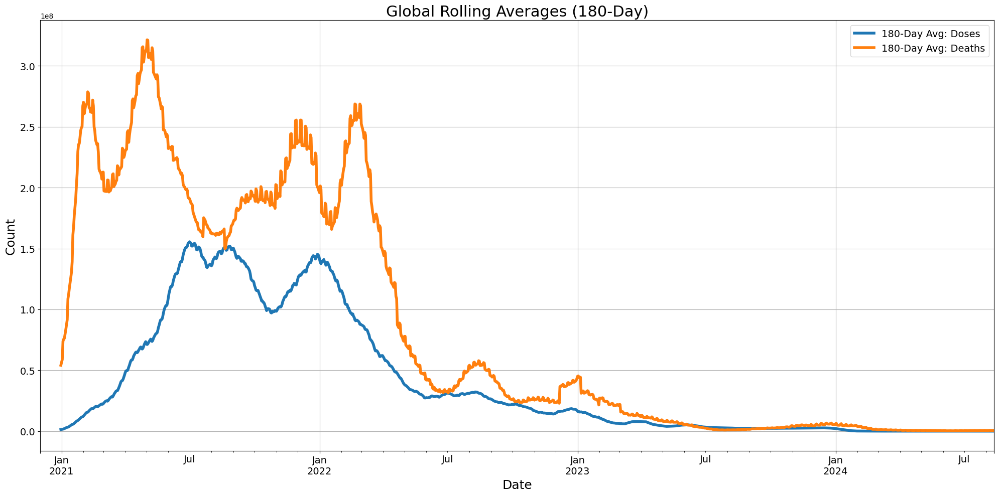

In [52]:
data_rolling180 = data_grouped.rolling(30).mean()
data_rolling180.plot(figsize=(20, 10), linewidth=4, fontsize=14)
plt.title('Global Rolling Averages (180-Day)', fontsize=22)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.grid(True)
plt.legend(['180-Day Avg: Doses', '180-Day Avg: Deaths'], fontsize=14)
plt.tight_layout()
plt.savefig("line_COVID-19_180mavg.png")
#graphs and saves with 6-month rolling averages

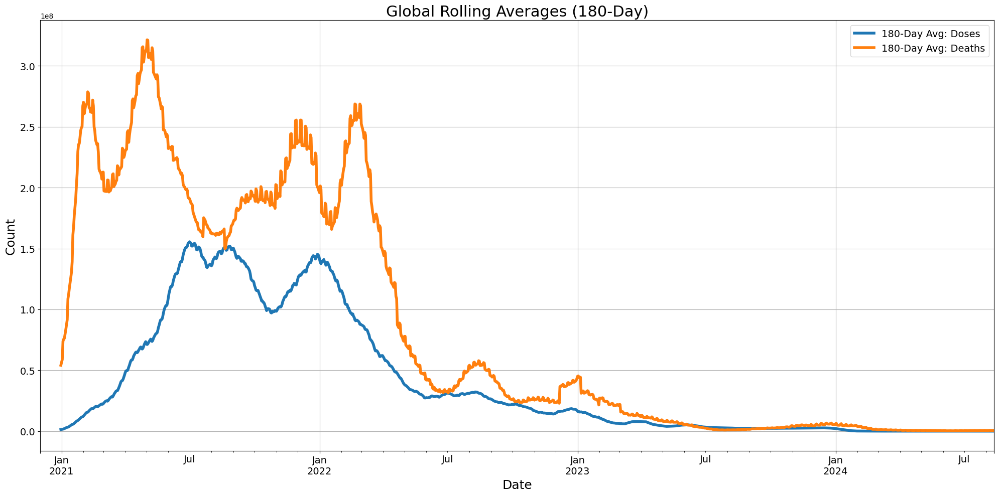

In [53]:
try:
    data_rolling180 = data_grouped.rolling(30).mean()
    data_rolling180.plot(figsize=(20, 10), linewidth=4, fontsize=14)
    plt.title('Global Rolling Averages (180-Day)', fontsize=22)
    plt.xlabel('Date', fontsize=18)
    plt.ylabel('Count', fontsize=18)
    plt.grid(True)
    plt.legend(['180-Day Avg: Doses', '180-Day Avg: Deaths'], fontsize=14)
    plt.tight_layout()
    plt.savefig("line_COVID-19_180mavg.png")
except Exception as e:
    print(f"Rolling averages plot failed: {e}")
#tests rolling data graphs

A line graph was generated, meeting test expectations.

There does appear to be a downward trend in both the vaccinations and deaths due to COVID-19.

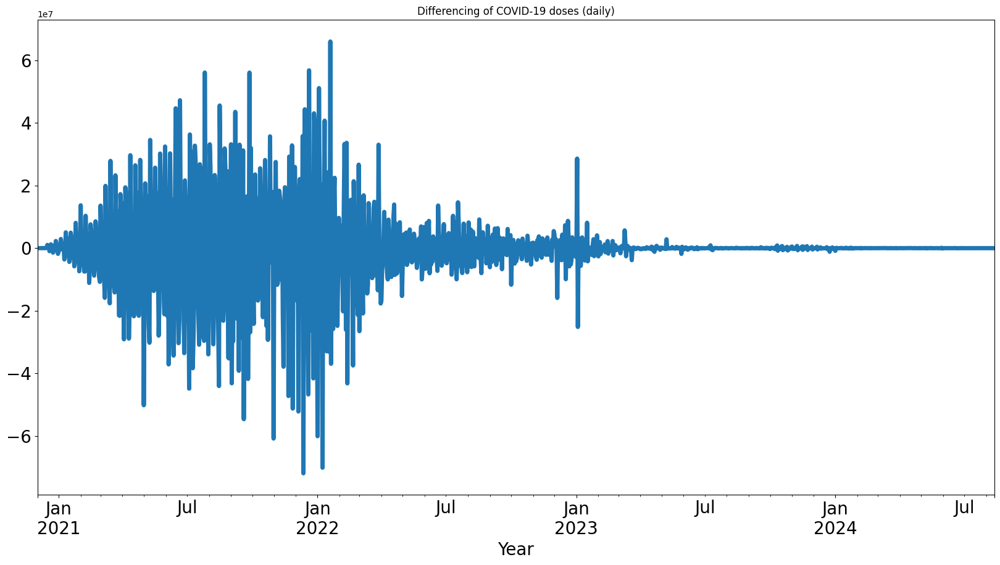

In [54]:
data_grouped['COVID-19 doses (daily)'].diff().plot(figsize=(20,10), linewidth=5, fontsize=20)
plt.xlabel('Year', fontsize=20)
plt.title("Differencing of COVID-19 doses (daily)")
plt.savefig("line_COVID-19_vaccine_differencing.png")
#graphs and saves differencing data to identify any seasonality

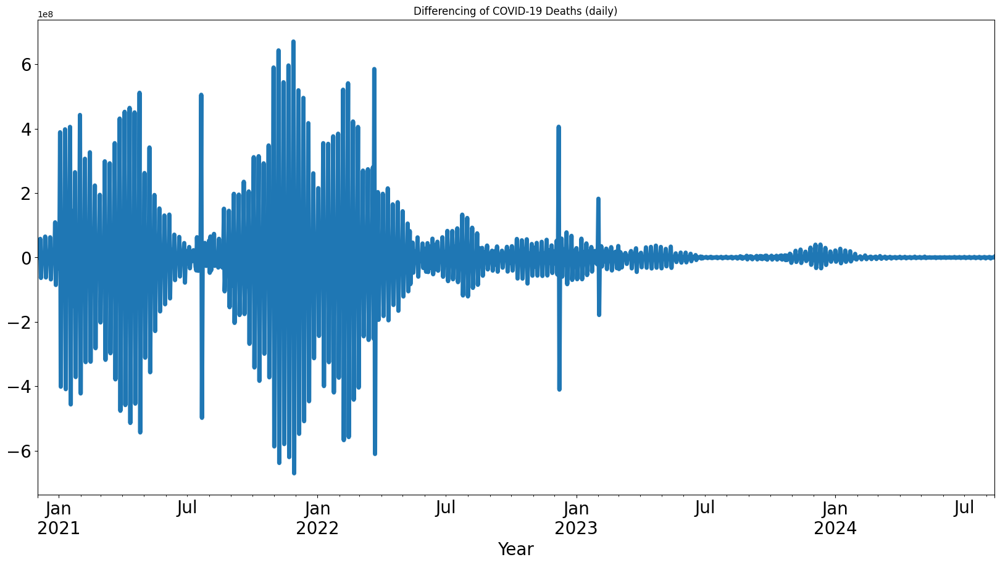

In [55]:
data_grouped['Daily new confirmed deaths due to COVID-19'].diff().plot(figsize=(20,10), linewidth=5, fontsize=20)
plt.xlabel('Year', fontsize=20)
plt.title("Differencing of COVID-19 Deaths (daily)")
plt.savefig("line_COVID-19_death_differencing.png")
#graphs and saves differencing data to identify any seasonality

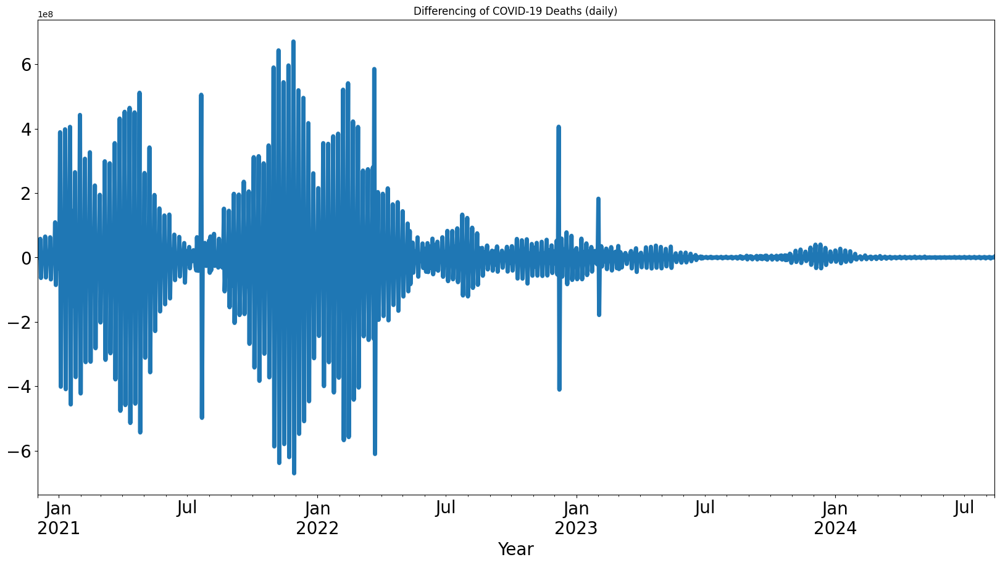

In [56]:
try:
    data_grouped['Daily new confirmed deaths due to COVID-19'].diff().plot(figsize=(20,10), linewidth=5, fontsize=20)
    plt.xlabel('Year', fontsize=20)
    plt.title("Differencing of COVID-19 Deaths (daily)")
    plt.savefig("line_COVID-19_death_differencing.png")
except Exception as e:
    print(f"Differencing plot failed: {e}")
# tests differencing graphs

A line graph was generated, meeting test expectations.

There appears to be some spikes in both variables around December and January. Applying seasonality feature engineering may benefit the models' performance.

In [57]:
t_statistic, p_value = stats.ttest_ind(data['COVID-19 doses (daily)'], data['Daily new confirmed deaths due to COVID-19'])
print("T-statistic:", t_statistic)
print("P-value:", p_value)
# finds t-test and p-value of variables

T-statistic: -32.42611102216666
P-value: 9.152921412001677e-230


In [58]:
try:
    t_statistic_test, p_value_test = stats.ttest_ind(data['COVID-19 doses (daily)'], data['Daily new confirmed deaths due to COVID-19'])
    print("T-statistic:", t_statistic_test)
    print("P-value:", p_value_test)
    if t_statistic_test == t_statistic:
        print("T-statistics are identical.")
    else:
        print("T-statistics are not equal.")
    if p_value_test == p_value:
        print("P-values are identical.")
    else:
        print("P-values are not equal.")
except Exception as e:
    print(f"Tstatistic and/or p-value failed: {e}")
# tests t-statistic and p-value

T-statistic: -32.42611102216666
P-value: 9.152921412001677e-230
T-statistics are identical.
P-values are identical.


Computation of t-statistic and p-values were replicable, thus meeting test expectations.

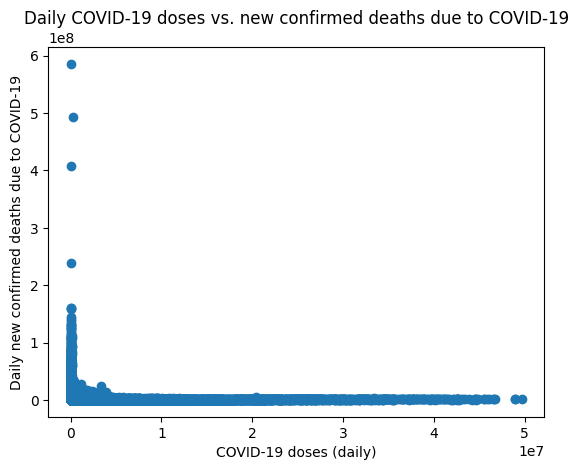

<Figure size 640x480 with 0 Axes>

In [59]:
plt.scatter(data['COVID-19 doses (daily)'], data['Daily new confirmed deaths due to COVID-19'])
plt.xlabel('COVID-19 doses (daily)')
plt.ylabel('Daily new confirmed deaths due to COVID-19')
plt.title('Daily COVID-19 doses vs. new confirmed deaths due to COVID-19')
plt.show()
plt.savefig("scatter_COVID-19.png")
#creates and saves a scatter plot of COVID-19 doses vs new confirmed COVID-19 deaths

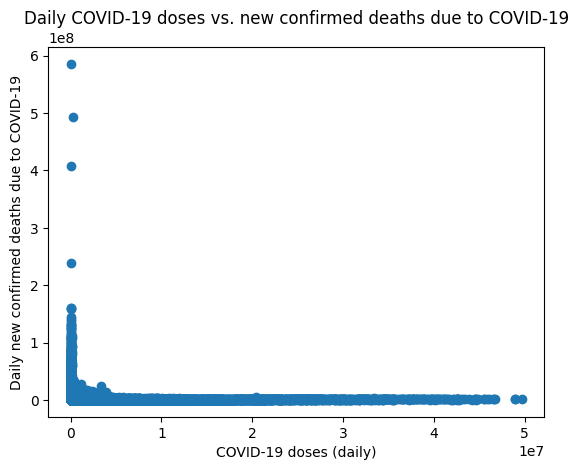

<Figure size 640x480 with 0 Axes>

In [61]:
try:
    plt.scatter(data['COVID-19 doses (daily)'], data['Daily new confirmed deaths due to COVID-19'])
    plt.xlabel('COVID-19 doses (daily)')
    plt.ylabel('Daily new confirmed deaths due to COVID-19')
    plt.title('Daily COVID-19 doses vs. new confirmed deaths due to COVID-19')
    plt.show()
    plt.savefig("scatter_COVID-19.png")
except Exception as e:
    print(f"Plot failed: {e}")
# tests if scatterplot generated

Scatterplot was generated, meeting test expectations.

In [62]:
data["Cumulative_Vaccination"] = data["COVID-19 doses (daily)"].cumsum()
data["Cumulative_Deaths"] = data["Daily new confirmed deaths due to COVID-19"].cumsum()
correlation_per_country = (
 data.groupby("Entity")[["Cumulative_Vaccination", "Cumulative_Deaths"]]
 .corr()
 .unstack()
 .iloc[:, 1]
)
correlation_df = correlation_per_country.reset_index().rename(columns={0: "Correlation"})
correlation_df.columns = ["Entity", "Correlation"]
# creates new data frame for correlations

In [63]:
try:
    data["Cumulative_Vaccination"] = data["COVID-19 doses (daily)"].cumsum()
    data["Cumulative_Deaths"] = data["Daily new confirmed deaths due to COVID-19"].cumsum()
    correlation_per_country = (
        data.groupby("Entity")[["Cumulative_Vaccination", "Cumulative_Deaths"]]
        .corr()
        .unstack()
        .iloc[:, 1]
    )
    correlation_df2 = correlation_per_country.reset_index().rename(columns={0: "Correlation"})
    correlation_df2.columns = ["Entity", "Correlation"]
    if 'correlation_df' in locals() and correlation_df2.equals(correlation_df):
        print("Dataframes are identical.")
    else:
        print("Cumulative correlation is not identical.")
except Exception as e:
    print(f"Creating cummulative data failed: {e}")
# tests cummulative dataframe

Dataframes are identical.


Identical data frames were generated, indicating the cummulative data is replicably computed. The test expectations were met.

In [64]:
fig_map1 = px.choropleth(data,
 locations="Entity",
 locationmode="country names",
color="COVID-19 doses (daily)",
title="COVID-19 doses (daily)",
color_continuous_scale="Viridis")
fig_map1.update_layout(
 updatemenus=[{
  "buttons": [
            {
                "label": "Daily Doses",
                "method": "update",
                "args": [{"z": [data["COVID-19 doses (daily)"]]}, {"title": "COVID-19 doses (daily)"}]
            },
            {
                "label": "Cumulative Doses",
                "method": "update",
                "args": [{"z": [data["Cumulative_Vaccination"]]}, {"title": "Cumulative COVID-19 Vaccinations"}]
            }
        ],
        "direction": "down",
        "showactive": True,
    }]
)

fig_map1.show()
# creates interactive map of CVOID-19 vaccinations adminsted

In [65]:
fig_map2 = px.choropleth(data,
 locations="Entity",
 locationmode="country names",
color="Daily new confirmed deaths due to COVID-19",
title="Daily new confirmed deaths due to COVID-19",
color_continuous_scale="Viridis")
fig_map2.update_layout(
 updatemenus=[{
   "buttons": [
            {
                "label": "Daily new confirmed deaths due to COVID-19",
                "method": "update",
                "args": [{"z": [data["Daily new confirmed deaths due to COVID-19"]]}, {"title": "Cummulative confirmed deaths due to COVID-19"}]
            },
            {
                "label": "Cumulative Doses",
                "method": "update",
                "args": [{"z": [data["Cumulative_Deaths"]]}, {"title": "Cummulative confirmed deaths due to COVID-19"}]
            }
        ],
        "direction": "down",
        "showactive": True,
    }]
)

fig_map2.show()
# creates interactive map of COVID-19 related deaths

In [66]:
try:
    fig_map2 = px.choropleth(data,
    locations="Entity",
    locationmode="country names",
    color="Daily new confirmed deaths due to COVID-19",
    title="Daily new confirmed deaths due to COVID-19",
    color_continuous_scale="Viridis")
    fig_map2.update_layout(
    updatemenus=[{
        "buttons": [
                {
                   "label": "Daily new confirmed deaths due to COVID-19",
                   "method": "update",
                   "args": [{"z": [data["Daily new confirmed deaths due to COVID-19"]]}, {"title": "Cummulative confirmed deaths due to COVID-19"}]
                },
                {
                    "label": "Cumulative Doses",
                    "method": "update",
                    "args": [{"z": [data["Cumulative_Deaths"]]}, {"title": "Cummulative confirmed deaths due to COVID-19"}]
                }
            ],
            "direction": "down",
            "showactive": True,
        }]
    )
    fig_map2.show()
except Exception as e:
    print(f"Plot failed: {e}")
 # tests px.choropleth()

Map of data was generated, showing that the test expectations were met.

### Data with Outlier Handling

In [67]:
data_nomean_out.describe()
#describes data

,"COVID-19 doses (daily, no outliers)",Daily new confirmed deaths due to COVID-19 (no outliers)
count,6.714000e+04,6.714000e+04
mean,5.873528e+05,1.461546e+06
std,1.808541e+06,3.278568e+06
min,0.000000e+00,0.000000e+00
25%,1.754321e+03,0.000000e+00
50%,2.243600e+04,1.763430e+05
75%,2.067128e+05,1.287972e+06
max,1.059670e+07,2.085322e+07


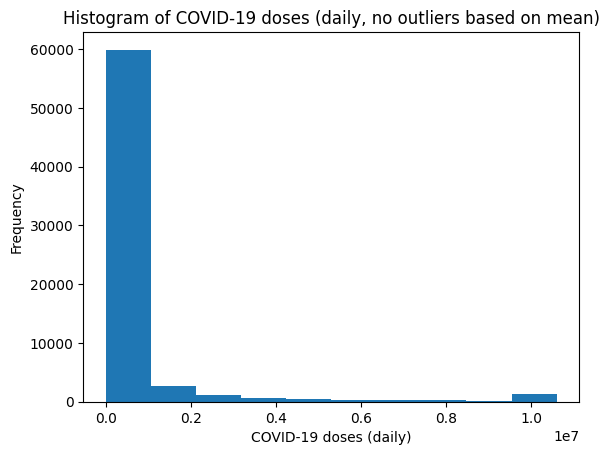

<Figure size 640x480 with 0 Axes>

In [68]:
plt.hist(data_nomean_out['COVID-19 doses (daily, no outliers)'])
plt.xlabel('COVID-19 doses (daily)')
plt.ylabel('Frequency')
plt.title('Histogram of COVID-19 doses (daily, no outliers based on mean)')
plt.show()
plt.savefig("hist_COVID-19_vaccine_mean.png")
#graphs and saves histogram of COVID-19 doses (daily) - data has no outliers based on standard deviations away

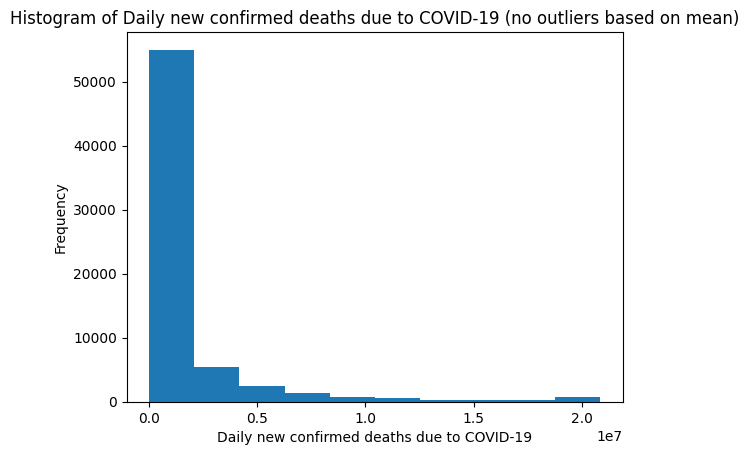

<Figure size 640x480 with 0 Axes>

In [69]:
plt.hist(data_nomean_out['Daily new confirmed deaths due to COVID-19 (no outliers)'])
plt.xlabel('Daily new confirmed deaths due to COVID-19')
plt.ylabel('Frequency')
plt.title('Histogram of Daily new confirmed deaths due to COVID-19 (no outliers based on mean)')
plt.show()
plt.savefig("hist_COVID-19_death_mean.png")
#graphs and saves histogram of Daily new confirmed deaths due to COVID-19 - data has no outliers based on standard deviations away

In [70]:
data_nomedian_out.describe()
#describes data

,"COVID-19 doses (daily, no outliers)",Daily new confirmed deaths due to COVID-19 (no outliers)
count,67140.000000,6.714000e+04
mean,135163.677435,8.187146e+05
std,192444.238032,1.146300e+06
min,0.000000,0.000000e+00
25%,1754.321450,0.000000e+00
50%,22436.000000,1.763430e+05
75%,206712.750000,1.287972e+06
max,514150.392825,3.219930e+06


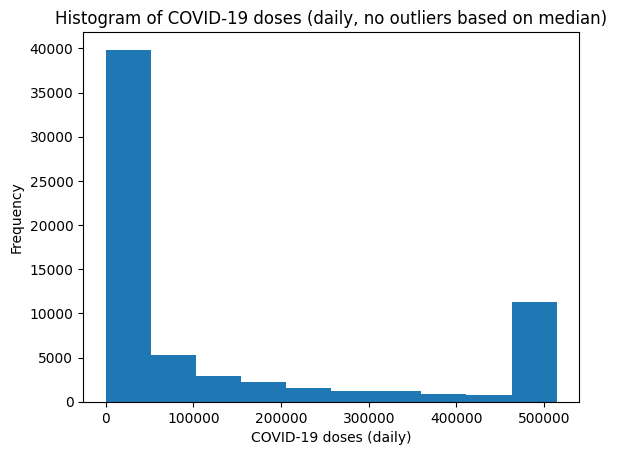

<Figure size 640x480 with 0 Axes>

In [71]:
plt.hist(data_nomedian_out['COVID-19 doses (daily, no outliers)'])
plt.xlabel('COVID-19 doses (daily)')
plt.ylabel('Frequency')
plt.title('Histogram of COVID-19 doses (daily, no outliers based on median)')
plt.show()
plt.savefig("hist_COVID-19_vaccine_median.png")
#graphs and saves histogram of COVID-19 doses (daily) - data has no outliers based on IQRs away

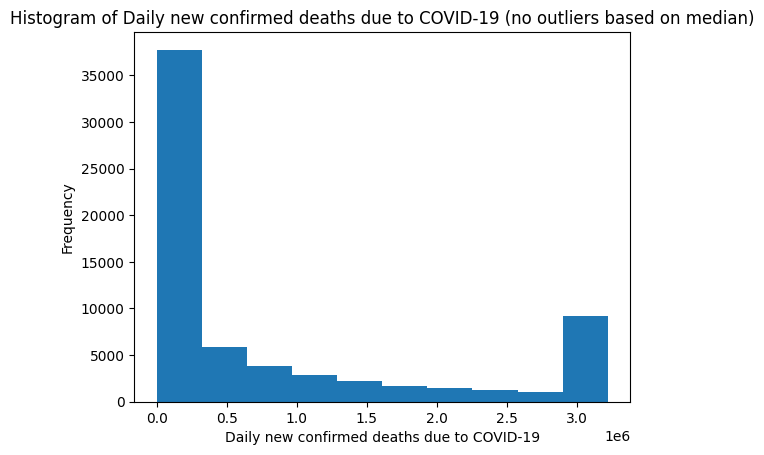

<Figure size 640x480 with 0 Axes>

In [72]:
plt.hist(data_nomedian_out['Daily new confirmed deaths due to COVID-19 (no outliers)'])
plt.xlabel('Daily new confirmed deaths due to COVID-19')
plt.ylabel('Frequency')
plt.title('Histogram of Daily new confirmed deaths due to COVID-19 (no outliers based on median)')
plt.show()
plt.savefig("hist_COVID-19_death_median.png")
#graphs and saves histogram of Daily new confirmed deaths due to COVID-19 - data has no outliers based on IQRs away

In [73]:
data_log.describe()
#prints summary of data after log transformation

,COVID-19 doses (daily),Daily new confirmed deaths due to COVID-19
count,67140.000000,67140.000000
mean,9.658036,8.522092
std,3.609422,6.585103
min,0.000000,0.000000
25%,7.470407,0.000000
50%,10.018467,12.080192
75%,12.239090,14.068580
max,17.720976,20.187863


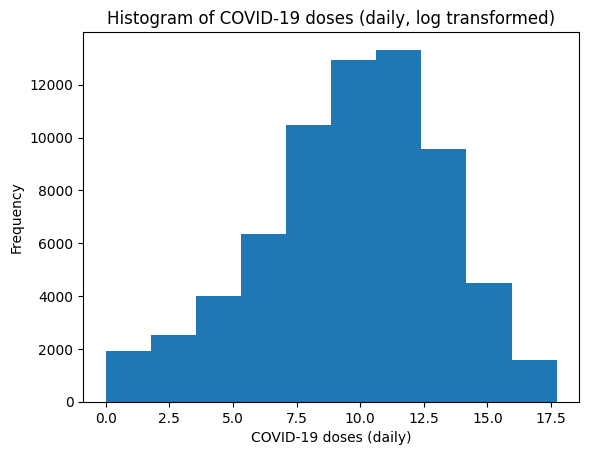

<Figure size 640x480 with 0 Axes>

In [74]:
plt.hist(data_log['COVID-19 doses (daily)'])
plt.xlabel('COVID-19 doses (daily)')
plt.ylabel('Frequency')
plt.title('Histogram of COVID-19 doses (daily, log transformed)')
plt.show()
plt.savefig("hist_COVID-19_vaccine_log.png")
#graphs and saves histogram of COVID-19 doses (daily, log transformed)

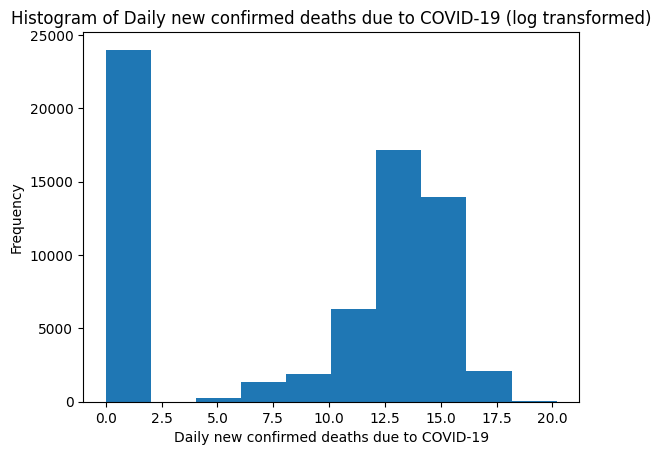

<Figure size 640x480 with 0 Axes>

In [75]:
plt.hist(data_log['Daily new confirmed deaths due to COVID-19'])
plt.xlabel('Daily new confirmed deaths due to COVID-19')
plt.ylabel('Frequency')
plt.title('Histogram of Daily new confirmed deaths due to COVID-19 (log transformed)')
plt.show()
plt.savefig("hist_COVID-19_death_log.png")
#graphs and saves histogram of Daily new confirmed deaths due to COVID-19, log transformed

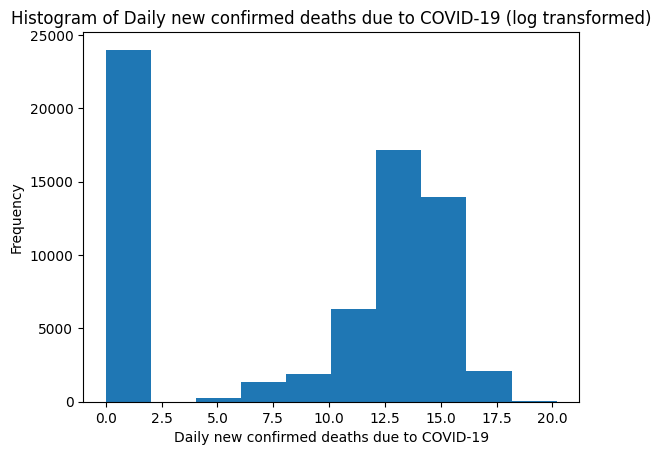

<Figure size 640x480 with 0 Axes>

In [76]:
try:
    plt.hist(data_log['Daily new confirmed deaths due to COVID-19'])
    plt.xlabel('Daily new confirmed deaths due to COVID-19')
    plt.ylabel('Frequency')
    plt.title('Histogram of Daily new confirmed deaths due to COVID-19 (log transformed)')
    plt.show()
    plt.savefig("hist_COVID-19_death_log.png")
except Exception as e:
    print(f"Plot failed: {e}")
# tests histogram

A histogram was generated, implicating that the test expectations were met.

In [77]:
data.to_csv('data_clean.csv', index=False)
data_nomean_out.to_csv('data_nomean_out.csv', index=False)
data_nomedian_out.to_csv('data_nomedian_out.csv', index=False)
data_log.to_csv('data_log.csv', index=False)
# saves cleaned data, outlier removed data (by standard deviaitons and IQRs), and log transformed data to use in other files

In [82]:
try:
    data.to_csv('data_clean.csv', index=False)
    data_nomean_out.to_csv('data_nomean_out.csv', index=False)
    data_nomedian_out.to_csv('data_nomedian_out.csv', index=False)
    data_log.to_csv('data_log.csv', index=False)
    print(f"Data save successful")
except Exception as e:
    print(f"Data save failed: {e}")
# tests that files are saved

Data save successful


Data files were successfully saved, showing the test expectations were met.

In [79]:
log_step("Data Explored")
#prints that step was completed

[2025-04-23 03:37:15] Data Explored


In [80]:
log_step("Stepwise Execution Complete")
log_step("Full Pipeline Execution Complete")
#finishes logging the steps in the data

[2025-04-23 03:37:16] Stepwise Execution Complete
[2025-04-23 03:37:16] Full Pipeline Execution Complete


A summary analysis of the original data showed that the mean number of
COVID-19 doses was 785,359 daily, and a standard deviation of 3,270,447 was
found. The median value of this was 22,436 and the interquartile range was
204,958.42855. As for the confirmed deaths per day, the mean was found to be
1,683,651, with a standard deviation of 6,389,856. The median for this was
found to be 176,343 and the interquartile range was 1,287,971.8. Both the doses
and deaths had means and standard deviations larger than that of the median
and interquartile ranges found. This provides evidence that the vaccination
doses and confirmed COVID-19 deaths are right-skewed.

After outlier removing through standard deviations away and interquartile ranges
away, the same results were found. The mean and standard deviations of COVID19 administered vaccinations were 785,359 and 3,270,447, respectively. The
median was calculated as 22,436. For the daily confirmed deaths, the values also In [54]: In [55]: were consistent between the differing outlier removals, with the mean as
1,683,651, standard deviation as 6,389,856, and median as 176,343. All of these
findings are also the same as those found in the original data. Graphs after
outlier removal techniques further show limited change in the data, as the
histograms are structured the same.

The logarithmic transformation, on the other hand, did exemplify differences
made upon the data set. For COVID-19 doses (daily), the mean became
9.658036, the standard deviations became 3.609422, and the median became
10.018467. The histogram post-transformation shows a more normal
distribution. With the daily new confirmed deaths, the mean transformed to
8.522092, the standard deviation to 6.585103, and the median to 12.080192.
This graph appears to now be bimodal, with a large presence at zero and then a
slightly left skewed distribution about the median.

Images five and six were created to show the potential trends and seasonality
within the data. While doses administered were high in 2021, there appears to
be a downward trend to the data. No seasonality is outwardly apparent, as all of
the peaks appear to be in the year 2021 and steady out over time. COVID-19
related deaths did not show any seasonality as well, due to most of the
significant peaks showing in the year 2021. There does appear to be potential for
a downward trend for the deaths, as they do appear to mostly decrease after
2021.

A scatterplot was also created to show the potential relationship between COVID19 doses and COVID-19 related deaths. There appears to be a strong, negative
relationship between the two variables. Their relationship is statistically
significant, as confirmed by the p-value between them, found to be
9.152921412001677e-230.

## GUI Elements

The main GUI elements implemented were in the early graphs while exploring
the data. As the main purpose of this product is to share results and knowledge
on model performance for pandemic related data. These graphs included Box
Plots for COVID-19 vaccinations and deaths, were a drop down box allowed for
specific locations or the entirety of the world data was viewed. The box plot is
important in outlier identification. This was also applied to histograms and line
plots of the COVID-19 doses and related deaths. Histograms are important in
understanding the structure of the data, while the line plot could be utilized to
indetify potential trends in the data. If an individual was interested in just local
information, or how this compared to another area or the entire world data, it is
now visually available to them for visualizing outliers, data structure, and trends.
Another visual aid provided was the COVID-19 vaccinations and deaths shown on
a map of the world. As the daily rates did not appear to add much context,
cumulative counts were added and applied as a drop down option for the graph.
This allows for people to see where potential areas of high or low activity for
vaccinations administered or deaths due to the virus. All utlizied the
update_layout() function from plotly (Plotly, n.d.). Otherwise, the product is fairly
straight-forward, as analysis models and their results are printed. The additions
enhance the user experience by providing a detailed and big picture viewpoints
of the data. This could aid in analysis by identifying any areas that appear
significant or as potential outliers to the user.

## Security

At this time, no security systems have been developed for the product. The data utilized is made publicly available and contains no personal identifiable information. As for the processing and modeling of the data, the purpose is for educational use, only. Testing of functions is performed to ensure all are appropriately working. If anyone were to make harmful changes to these, then they would only be preventing themselves from gaining insightful results.

If users upload data that contains personal information or develop their own product that is used for important decision making, then it is recommended that more measures are included for security. Additionally, any externally uploaded data should be fully preprocessed, as the current data was. The only exception is no implementations were performed for analyzing that the data type was appropriate for the data, as this must be examined and changed on an individual basis. All cleaning and preprocessing steps should be examined with introduction of new data, as well as analyzing the newly uploaded data for validity.

There is a risk that others could make changes to the models, and therefore, change the integrity of the model. It is recommended to all users to review the models for appropriate structure prior to implementation.

## Revisions

New additions to the product included more references, addressing security, creating a pop-up to allow url data uploads, adding tests to each function, and a help guide at the top of each file.

Updates to the files included a more in depth exploration of potential seasonality and trends in the data, fixing code to actually use the split of the train and test data, and updating codes so no warnings or error messages were received.

Failed attempts at revisions were introducing more feature engineering techniques for Poisson Regression, Random Forest, and DNN modeling. Introducing seasonality did not show increase performance in the models. As previous research has shown more success at predicting with more localized data, it is recommended to take this approach when analyzing pandemic related data.

From this information and the poor performance across all models, future goals are to attempt to rectify prior errors at improving model performance in new files. If these still return poor results, an exploration of learning data at a more local level will be the new objective to compare performance against.

For adherence to industry standards, it is imperative to have reproducibile and replicabile results (Gîrjău, Horton, & Pruim, 2023). Given this information, it is recommended to not make decisions from any of the current models. Any further implementations should focus on the logarithmic transformed data set. Additionally, the elimination of errors and warning messages follows best practices. It is also recommended to learn from the work of others. Prior work was used when devloping the models, as seen in the inserted referneces.

## References 

Aguinis, H., Gottfredson, R. K., & Joo, H. (2013). Best-practice recommendations for defying, idenfitying, and handling outliers. *Organizational Research Methods, 16*(2). https://doi.org/10.1177/1094428112470848

Alroy-Preis, S., Angulo, F. Anis, E., Brooks, N., Haas, E. J., Jodar, :., Khan, F., Levy, Y., McLaughlin, J. M., Mircus, G., Pan, K., Singer, S. R., Smaja, M., Southern, J., & Swerdlow, D. L. (2021). Impact and effectiveness of mRNA BNT162b2 vaccine against SARS-CoV-2 infections and COVID-19 cases, hospitalisations, and deaths following a nationwide vaccination campaign in Israel: an observational study using national surveillance data. *Lancet, 397*(10287), 1819-1829. doi: 10.1016/S0140-6736(21)00947-8 

Appel, C., Beltekian, D., Dattani, S., Gavrilov, D., Giattino, C., Hasell, J.,
Macdonald, B., Mathieu, E., Ortiz-Ospina, E., Ritchie, H., Rodes-Guirao, L., &
Roser, M. (2025). COVID-19 pandemic [Data set]. *Our World in Data.*
https://ourworldindata.org/coronavirus

Barbeira, P. B., Bartolomeu, M. L., Castelli, J. M., Del Valle Juarez, M., Esperatti, M., Fuentes, N., Galligani, G., Giovacchini, C. M., Iummato, L. E., Laurora, M., Pennini, V., Pesce, M., Rearte, A. Rearte, R., Santoro, A., Tarragona, S., & Vizzotti, C. (2022). Effectiveness of rAd26-rAd5, ChAdOx1 nCoV-19, and BBIBP-CorV vaccines for risk of infection with SARS-CoV-2 and death due to COVID-19 in people older than 60 years in Argentina: a test-negative, case-control, and retrospective longitudinal study. *Lancet, 399*(10331), 1254-1264. doi: 10.1016/S0140-6736(22)00011-3 

Barron, J. A., Buenrostro-Mariscal, R., Crossa, J., Montesinos-Lopez, A.
Montesinos-Lopez, J. C., Montesinos-Lopez, O. A., & Salazar, E. (2021).
Application of a Poisson deep neural network model for the prediction of count
data in genome-based prediction. *The Plant Genome, 14*(3).
https://doi.org/10.1002/tpg2.20118

Brownlee, J. (2022). Your first deep learning project in Python with Keras step-by-step. *Machine Learning Mastery.* https://machinelearningmastery.com/tutorial-first-neural-network-python-keras/

Elliott, L., Loomis, D., & Richardson, D. B. (2005). Poisson regression analysis of
ungrouped data. *Occupational and Environmental Medicine, 62*, 325-329. DOI:
10.1136/oem.2004.017459

Fandohan, A. B., Kakaï, R. G., & Mushaglusa, C. Z. (2022). Random forest in count
data modelling: An analysis of the influence of data features and overdispersion
on regression performance. *Journal of Probability and Statistics, 1*.
https://doi.org/10.1155/2022/2833537

GeeksforGeeks. (2025). Random forest regression in Python. https://www.geeksforgeeks.org/random-forest-regression-in-python/ 

Gîrjău, M., Horton, N. J., & Prium, R. (2023). Fostering better coding practices for data scientists. *HDSR.* https://hdsr.mitpress.mit.edu/pub/8wsiqh1c/release/4

Katla, N. (2020). Poisson regression implementation- Python. *Medium.* https://medium.com/@kn12/poisson-regression-implementation-python-28d15e95dc15

Liu, J. (2024). Navigating the financial landscape: The power and limitations of
the ARIMA model. *Highlights in Science, Engineering and Technology, 88*, 747-752. https://drpress.org/ojs/index.php/HSET/article/view/19082/18645

National Cancer Institute. (2023). Cleaning data: The basics. *Center for
Biomedical Informatics and Information Technology.*
https://datascience.cancer.gov/training/learn-data-science/clean-data-basics

The Pennsylvania State University. (n.d.). 9: Poisson Regression.
https://online.stat.psu.edu/stat504/book/export/html/782#:~:text=Interpretations,tabletop%20of%20a%20certain%20area

Plotly. (n.d.). Creating and updating figures in Python.
https://plotly.com/python/creating-and-updating-figures/#updating-figures

Sarahjane3102. (2022). How to split the dataset With scikit-learn’s train_test_split() function *GeeksforGeeks.* https://www.geeksforgeeks.org/how-to-split-the-dataset-with-scikit-learns-train_test_split-function/